In [2]:
import tensorflow as tf
import numpy as np
from tensorflow import keras
from keras.models import Sequential
from keras.layers import Activation, Dense, Flatten, BatchNormalization,Dropout
from keras.optimizers import Adam
from keras.metrics import categorical_crossentropy
from keras.preprocessing.image import ImageDataGenerator
import os, sys
import matplotlib.pyplot as plt
import librosa
from librosa import display
from tensorflow.keras.utils import to_categorical
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import pandas as pd

In [3]:
os.chdir('/content/drive/MyDrive/Audio_controlled_drone/wavdata')

In [4]:
hover = []
land = []
mback = []
mfor = []
mleft = []
mright = []
takeoff = []

hover = os.listdir('hover')
land = os.listdir('land')
mback = os.listdir('mback')
mfor = os.listdir('mfor')
mleft = os.listdir('mleft')
mright = os.listdir('mright')
takeoff = os.listdir('takeoff')

names_list  = ['hover', 'land', 'mback', 'mfor', 'takeoff', 'mleft', 'mright']
list = [hover, land, mback, mfor, takeoff, mleft, mright]

In [5]:
!dir

FTimages  hover  land  mback  MELimages  mfor  mleft  model.h5	mright	takeoff


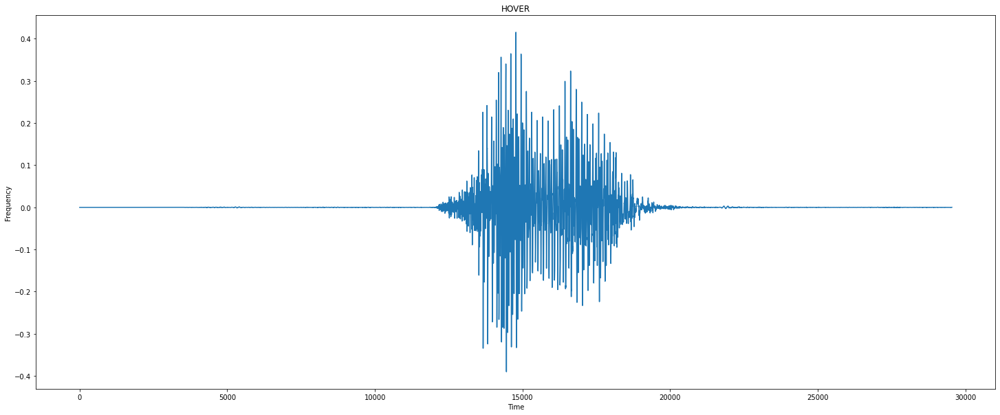

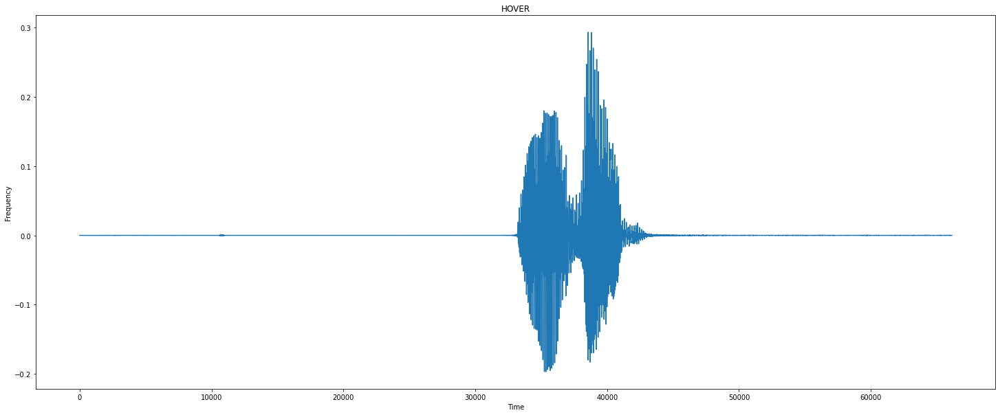

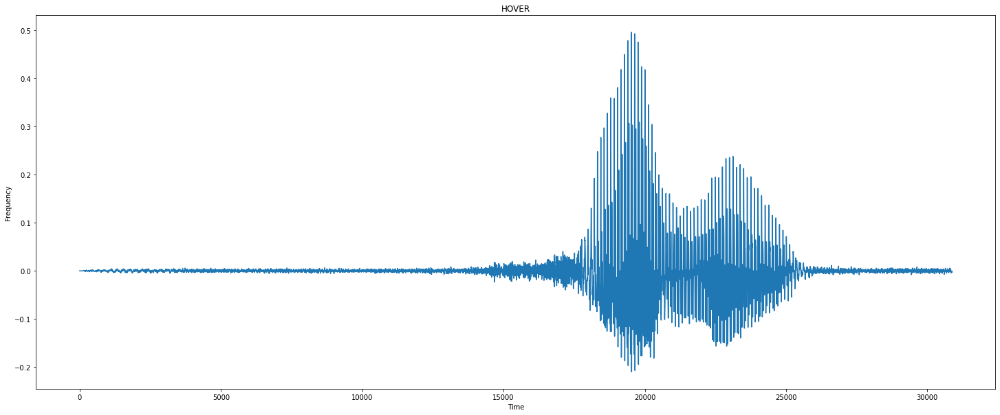

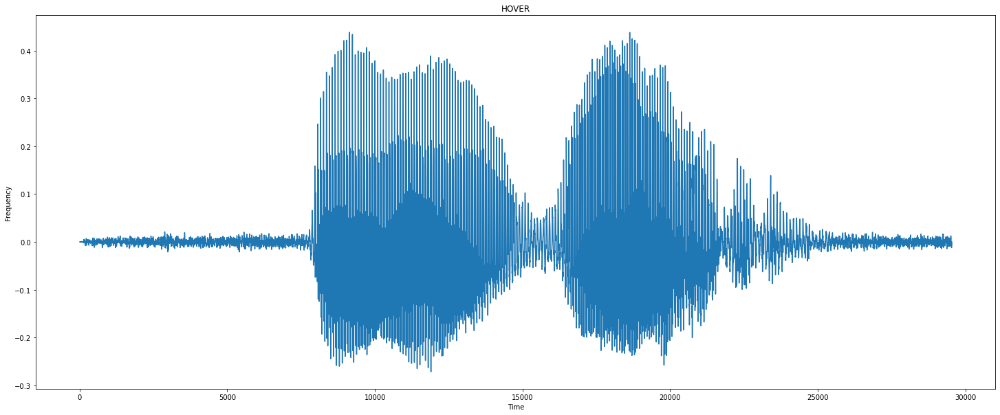

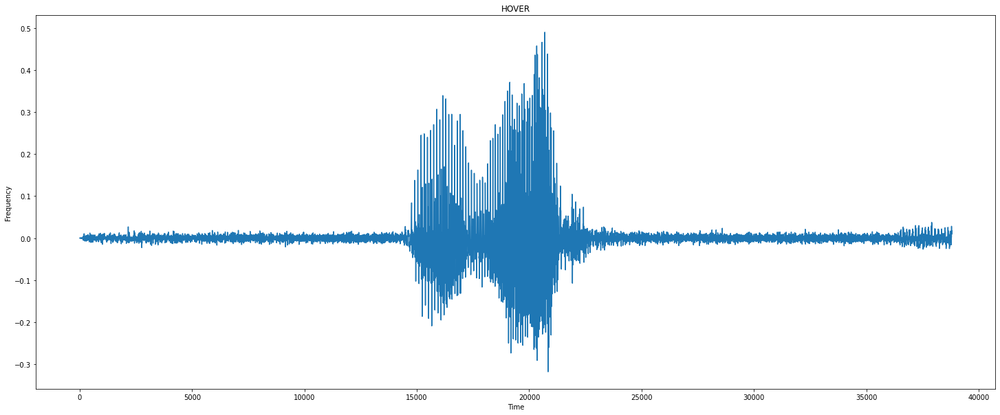

...

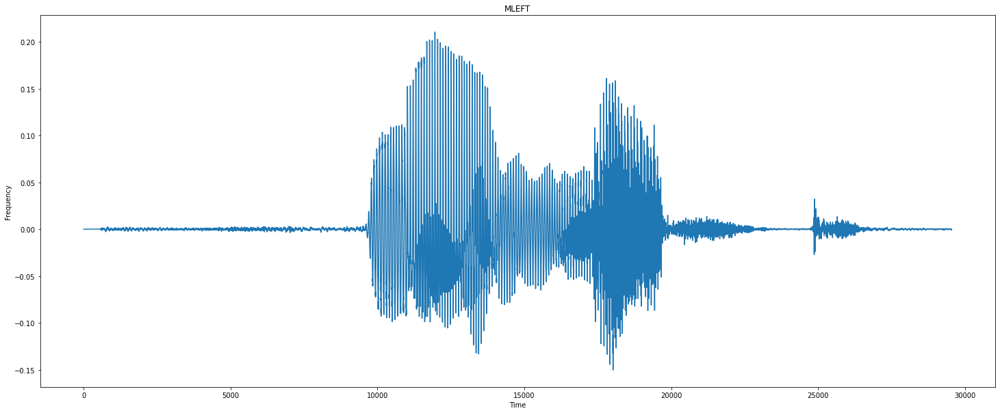

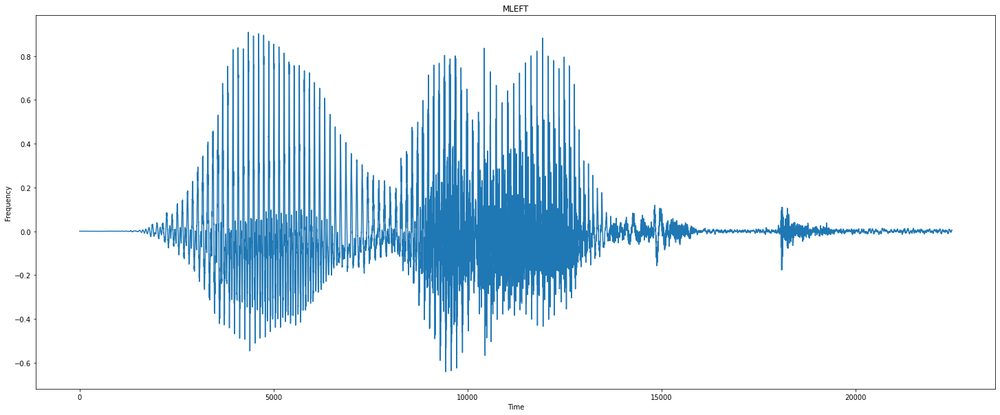

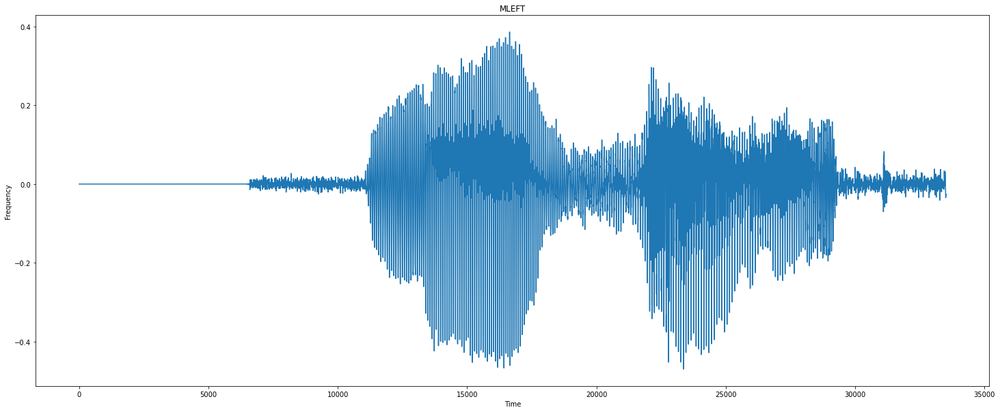

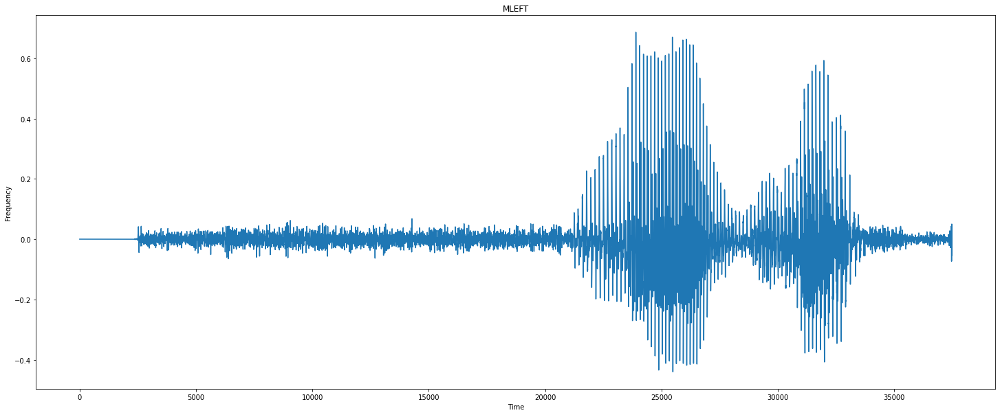

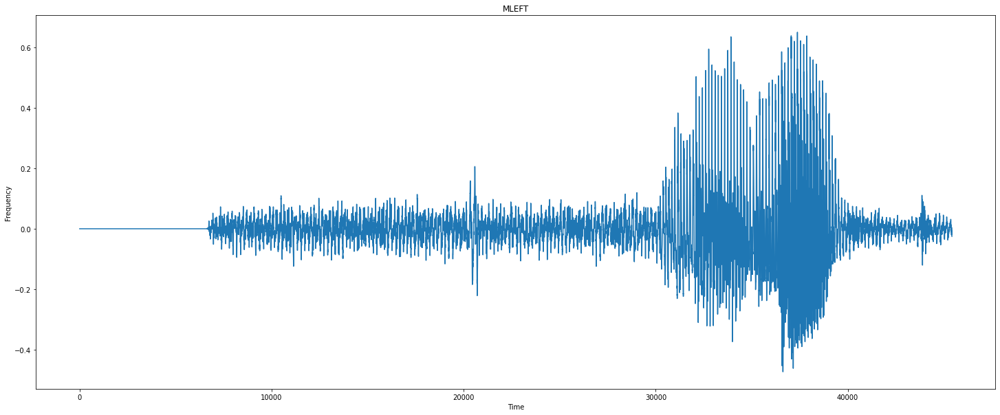

Buffered data was truncated after reaching the output size limit.

In [7]:

rows = 2
columns = 4
r=0
for i in list:
    for j in range(100):
        fig = plt.figure(figsize=(25, 10))
        # fig.add_subplot(rows, columns, r+1)
        k = names_list[r]+'/'+names_list[r]+str(j)
        audio, sample_rate = librosa.load(k+'.wav', duration=3) 
        plt.plot(audio)
        plt.axis('on')
        plt.title(names_list[r].upper())
        plt.xlabel("Time")
        plt.ylabel("Frequency")
        plt.savefig('FTimages/'+k+'.jpg', bbox_inches="tight", pad_inches=0.3, transparent=True)
        plt.show()
    r+=1

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
fig = plt.figure(figsize=(26, 10))
rows = 2
columns = 4
r=0
for i in list:
  for j in range(100):
    fig.add_subplot(rows, columns, r+1)
    audio, sample_rate = librosa.load(names_list[r]+'/'+names_list[r]+str(j)+'.wav', duration=3) 
    mels = librosa.feature.melspectrogram(y=audio,sr=sample_rate)
    librosa.display.specshow(librosa.power_to_db(mels,ref=np.max), sr=sample_rate, x_axis='time', y_axis='mel')
    plt.title(names_list[r].upper())
    plt.savefig('MELimages/'+names_list[r]+'/'+names_list[r]+str(j)+'.jpg', bbox_inches="tight", pad_inches=0.3, transparent=True)
  r+=1